<a href="https://colab.research.google.com/github/ArtBreguez/ArtBreguez/blob/main/Backtesting-notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install numpy==1.24.4 --force-reinstall


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 48.4 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 1.24.4 which is incompatible.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.24.4 which is incompatible.
treescope 0.1.9 requires numpy>=1.25.2, but you have numpy 1.24.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.24.4 which is incompatible.
pymc 5.23.0 requires numpy>=1.25.0, but you have numpy 1.24.4 which is incompatible.
blosc2 3.5.1 requires numpy>=1.26, but you have numpy 1.24.4 which is incompatible.
xarray-einstats 0.

In [2]:
!pip install backtesting

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 191.4/191.4 kB 4.5 MB/s eta 0:00:00


In [3]:
!curl -L http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz -O && tar xzvf ta-lib-0.4.0-src.tar.gz
!cd ta-lib && ./configure --prefix=/usr && make && make install && cd - && pip install TA-Lib==0.4.37 --no-cache-dir --force

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   380  100   380    0     0   2043      0 --:--:-- --:--:-- --:--:--  2054
100   379  100   379    0     0   1041      0 --:--:-- --:--:-- --:--:--  1041
100 1299k  100 1299k    0     0  1674k      0 --:--:-- --:--:-- --:--:-- 4395k
ta-lib/
ta-lib/config.sub
ta-lib/aclocal.m4
ta-lib/CHANGELOG.TXT
ta-lib/include/
ta-lib/include/ta_abstract.h
ta-lib/include/ta_func.h
ta-lib/include/ta_common.h
ta-lib/include/ta_config.h.in
ta-lib/include/Makefile.am
ta-lib/include/ta_libc.h
ta-lib/include/ta_defs.h
ta-lib/missing
ta-lib/ta-lib.spec.in
ta-lib/config.guess
ta-lib/Makefile.in
ta-lib/ta-lib.dpkg.in
ta-lib/Makefile.am
ta-lib/autogen.sh
ta-lib/install-sh
ta-lib/configure
ta-lib/depcomp
ta-lib/HISTORY.TXT
ta-lib/configure.in
ta-lib/autom4te.cache/
ta-lib/autom4te.cache/output.0
ta-lib/autom4te.cache/requests
ta-lib/autom4te.cache/outpu

In [3]:
!pip install ccxt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 131.6/131.6 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 40.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 628.0/628.0 kB 30.1 MB/s eta 0:00:00


In [4]:
# Remove Future Warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# General
import numpy as np

# Data Management
import pandas as pd
from sklearn.model_selection import train_test_split

# Machine Learning
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV, cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

# Binary Classification Specific Metrics
from sklearn.metrics import RocCurveDisplay as plot_roc_curve

# General Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, roc_auc_score
from sklearn.metrics import precision_score
from sklearn.metrics import ConfusionMatrixDisplay

# Reporting
import matplotlib.pyplot as plt
from matplotlib.pylab import rcParams
from xgboost import plot_tree

#Backtesting
from backtesting import Backtest
from backtesting import Strategy

#hyperopt
from hyperopt import fmin, tpe, hp

from pandas_datareader.data import DataReader

from datetime import datetime
import talib as ta
import ccxt

/usr/local/lib/python3.11/dist-packages/backtesting/_plotting.py:55: UserWarning: Jupyter Notebook detected. Setting Bokeh output to notebook. This may not work in Jupyter clients without JavaScript support, such as old IDEs. Reset with `backtesting.set_bokeh_output(notebook=False)`.
  warnings.warn('Jupyter Notebook detected. '


In [5]:

# Caminho do arquivo
file_path = "/content/xauusd-s15-mid-2023-12-28-2024-12-28.csv"

# Lê o CSV
df = pd.read_csv(file_path)

FileNotFoundError: [Errno 2] No such file or directory: '/content/xauusd-s15-mid-2023-12-28-2024-12-28.csv'

In [ ]:
df

,timestamp,open,high,low,close
0,2023-12-27 19:00:00-05:00,2079.6555,2079.7800,2079.6150,2079.6650
1,2023-12-27 19:00:15-05:00,2079.6550,2079.7985,2079.5935,2079.7935
2,2023-12-27 19:00:30-05:00,2079.7750,2079.8450,2079.7450,2079.7550
3,2023-12-27 19:00:45-05:00,2079.7900,2079.8650,2079.7900,2079.8050
4,2023-12-27 19:01:00-05:00,2079.8400,2079.8450,2079.6985,2079.7000
...,...,...,...,...,...
2107675,2024-12-27 16:58:45-05:00,2621.3215,2621.3215,2621.3215,2621.3215
2107676,2024-12-27 16:59:00-05:00,2621.2745,2621.4265,2621.2465,2621.2815
2107677,2024-12-27 16:59:15-05:00,2621.2515,2621.3515,2621.2515,2621.3515
2107678,2024-12-27 16:59:30-05:00,2621.3765,2621.4515,2621.1045,2621.1515


In [ ]:
# Converte timestamp para datetime (forçando erro em linhas inválidas)
df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')

# Remove values where timestamp conversion failed
df = df.dropna(subset=['timestamp'])

# Set timestamp as index
df = df.set_index('timestamp')

# Convert index to datetime if it's not already and remove timezone
if not isinstance(df.index, pd.DatetimeIndex):
    df.index = pd.to_datetime(df.index, errors='coerce')

# Remove timezone if the index is timezone-aware
if df.index.tz is not None:
    df.index = df.index.tz_convert(None)

# Agrupa para 15 minutos
df_agg = df.resample('15T').agg({
    'open': 'first',
    'high': 'max',
    'low': 'min',
    'close': 'last'
})

# Remove empty candles
df_agg = df_agg.dropna()

# Renomeia colunas
df_agg.rename(columns={
    'open': 'Open',
    'high': 'High',
    'low': 'Low',
    'close': 'Adj Close'
}, inplace=True)


# Organiza colunas
df_agg = df_agg[['Open', 'High', 'Low', 'Adj Close']]

# Formata índice como string (opcional)
df_agg.index.name = 'Date'
df_agg.index = df_agg.index.strftime('%m-%d-%Y %H:%M')

df_agg

,Open,High,Low,Adj Close
Date,,,,
12-28-2023 00:00,2079.6555,2081.2155,2079.5935,2079.9500
12-28-2023 00:15,2079.9750,2080.4600,2079.6465,2080.0645
12-28-2023 00:30,2080.0650,2080.6000,2079.9895,2080.1865
12-28-2023 00:45,2080.2245,2080.7265,2079.2715,2079.8050
12-28-2023 01:00,2079.7850,2081.6300,2079.6600,2081.0100
...,...,...,...,...
12-27-2024 20:45,2613.5750,2617.0415,2613.5450,2615.5335
12-27-2024 21:00,2615.5585,2616.6350,2615.4535,2616.6250
12-27-2024 21:15,2616.6950,2616.8750,2615.9250,2616.4485


In [ ]:
df = df_agg

In [ ]:
# Add Returns and Range
target_prediction_number = 2
df["Returns"] = (df["Adj Close"] / df["Adj Close"].shift(target_prediction_number)) - 1
df["Range"] = (df["High"] / df["Low"]) - 1
df["Volatility"] = df['Returns'].rolling(window=target_prediction_number).std()
df.dropna(inplace=True)
print("Length: ", len(df))
df

Length:  8221


,Open,High,Low,Adj Close,Returns,Range,Volatility
Date,,,,,,,
12-28-2023 00:45,2080.2245,2080.7265,2079.2715,2079.8050,-0.000125,0.000700,0.000169
12-28-2023 01:00,2079.7850,2081.6300,2079.6600,2081.0100,0.000396,0.000947,0.000368
12-28-2023 01:15,2081.0000,2084.1055,2080.9900,2084.0250,0.002029,0.001497,0.001155
12-28-2023 01:30,2083.9800,2084.8500,2082.7850,2083.8700,0.001374,0.000991,0.000463
12-28-2023 01:45,2083.9500,2087.8400,2083.8700,2087.0750,0.001464,0.001905,0.000063
...,...,...,...,...,...,...,...
12-27-2024 20:45,2613.5750,2617.0415,2613.5450,2615.5335,0.000864,0.001338,0.001080
12-27-2024 21:00,2615.5585,2616.6350,2615.4535,2616.6250,0.001196,0.000452,0.000234
12-27-2024 21:15,2616.6950,2616.8750,2615.9250,2616.4485,0.000350,0.000363,0.000598


In [ ]:
# Add Moving Average
df["MA_12"] = df["Adj Close"].rolling(window=12).mean()
df["MA_21"] = df["Adj Close"].rolling(window=21).mean()

def trade_signal(dataframe=df, rsi_tp=19, bb_tp=16, vol_long=42, vol_short=29):
    # Compute indicators

    dataframe['RSI'] = ta.RSI(dataframe['Adj Close'], timeperiod=rsi_tp)
    dataframe['upper_band'], dataframe['middle_band'], dataframe['lower_band'] = ta.BBANDS(dataframe['Adj Close'], timeperiod=bb_tp)
    dataframe['macd'], dataframe['signal'], _ = ta.MACD(dataframe['Adj Close'])

    conditions_long = ((dataframe['RSI'] > 50) &
                       (dataframe['Adj Close'] > dataframe['middle_band']) &
                       (dataframe['Adj Close'] < dataframe['upper_band']) &
                       (dataframe['macd'] > dataframe['signal']) &
                       ((dataframe['High'] - dataframe['Adj Close']) < (dataframe['Adj Close'] - dataframe['Open'])) &
                       (dataframe['Adj Close'] > dataframe['Open']))

    conditions_short = ((dataframe['RSI'] < 50) &
                        (dataframe['Adj Close'] < dataframe['middle_band']) &
                        (dataframe['Adj Close'] > dataframe['lower_band']) &
                        (dataframe['macd'] < dataframe['signal']) &
                        ((dataframe['Adj Close'] - dataframe['Low']) < (dataframe['Open'] - dataframe['Adj Close'])) &
                        (dataframe['Adj Close'] < dataframe['Open']))

    dataframe['trend'] = 0
    dataframe.loc[conditions_long, 'trend'] = 1
    dataframe.loc[conditions_short, 'trend'] = 2

    dataframe.dropna(inplace=True)

    return dataframe

# trading_signal = trade_signal(dataframe=df, rsi_tp=19, bb_tp=16, vol_long=42, vol_short=29)
df['trade_signal'] = trade_signal(dataframe=df, rsi_tp=19, bb_tp=16, vol_long=42, vol_short=50)['trend']
df['Close'] = df['Adj Close']

df.info()

# Check for inf or nan values
inf_mask = np.isinf(df) | np.isnan(df)

# Remove rows containing inf or nan values
df_cleaned = df[~inf_mask.any(axis=1)]

# Remove columns containing inf or nan values
df = df_cleaned.loc[:, ~inf_mask.any(axis=0)]
df.dropna(inplace=True)

df

<class 'pandas.core.frame.DataFrame'>
Index: 8188 entries, 12-28-2023 09:00 to 12-27-2024 21:45
Data columns (total 18 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Open          8188 non-null   float64
 1   High          8188 non-null   float64
 2   Low           8188 non-null   float64
 3   Adj Close     8188 non-null   float64
 4   Returns       8188 non-null   float64
 5   Range         8188 non-null   float64
 6   Volatility    8188 non-null   float64
 7   MA_12         8188 non-null   float64
 8   MA_21         8188 non-null   float64
 9   RSI           8188 non-null   float64
 10  upper_band    8188 non-null   float64
 11  middle_band   8188 non-null   float64
 12  lower_band    8188 non-null   float64
 13  macd          8188 non-null   float64
 14  signal        8188 non-null   float64
 15  trend         8188 non-null   int64  
 16  trade_signal  8188 non-null   int64  
 17  Close         8188 non-null   float64
dtypes: flo

,Open,High,Low,Adj Close,Returns,Range,Volatility,MA_12,MA_21,RSI,upper_band,middle_band,lower_band,macd,signal,trend,trade_signal,Close
Date,,,,,,,,,,,,,,,,,,
12-28-2023 09:00,2077.5400,2078.1950,2072.9945,2074.2900,-0.001747,0.002509,0.001210,2082.598167,2084.244857,33.491481,2091.641826,2083.490344,2075.338861,-2.098373,-0.498835,0,0,2074.2900
12-28-2023 09:15,2074.2800,2075.8935,2073.1475,2074.9850,-0.001206,0.001325,0.000383,2081.766917,2083.708429,35.611252,2091.563358,2082.714437,2073.865517,-2.437487,-0.886565,0,0,2074.9850
12-28-2023 09:30,2074.9655,2078.0085,2074.3150,2076.3300,0.000983,0.001781,0.001548,2080.958583,2083.209381,39.547176,2091.211553,2082.080906,2072.950260,-2.568104,-1.222873,0,0,2076.3300
12-28-2023 09:45,2076.3200,2077.9500,2075.7705,2077.0800,0.001010,0.001050,0.000019,2080.227792,2082.761524,41.646707,2090.750256,2081.534562,2072.318869,-2.581343,-1.494567,0,0,2077.0800
12-28-2023 10:00,2077.0735,2079.3685,2077.0735,2078.0300,0.000819,0.001105,0.000135,2079.471958,2082.352952,44.236124,2090.280438,2081.100187,2071.919937,-2.486516,-1.692957,0,0,2078.0300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12-27-2024 20:45,2613.5750,2617.0415,2613.5450,2615.5335,0.000864,0.001338,0.001080,2617.311750,2617.198095,42.946155,2621.190972,2616.956750,2612.722528,-1.430733,-1.376832,0,0,2615.5335
12-27-2024 21:00,2615.5585,2616.6350,2615.4535,2616.6250,0.001196,0.000452,0.000234,2617.200500,2617.123333,45.197674,2621.201599,2617.021000,2612.840401,-1.318320,-1.365130,0,0,2616.6250
12-27-2024 21:15,2616.6950,2616.8750,2615.9250,2616.4485,0.000350,0.000363,0.000598,2617.142750,2617.108262,44.895266,2621.207678,2617.052781,2612.897884,-1.229304,-1.337965,0,0,2616.4485


In [ ]:
# prompt: quero contar a quantidade total de cade tipo de valor na coluna trend

df['trade_signal'].value_counts()

,count
trade_signal,
0,6678
1,817
2,693


In [ ]:
# prompt: mostre o range maximo dos valores da coluna rsi

print("Maximum range of RSI:", df['RSI'].max() - df['RSI'].min())


Maximum range of RSI: 84.01085482868908


In [ ]:
df = df.reset_index(inplace=False)
df['Date'] = pd.to_datetime(df['Date'])
df.set_index('Date', inplace=True)
df

def SIGNAL(df):
    return df.trend

class MyCandlesStrat(Strategy):
    def init(self):
        super().init()
        self.signal1 = self.I(SIGNAL, self.data)

    def next(self):
        super().next()
        if self.signal1==1:
            sl1 = self.data.Close[-1] - 6
            tp1 = self.data.Close[-1] + 3
            #tp1 = self.data.upper_band[-1]
            #sl1 = self.data.lower_band[-1]
            self.buy(sl=sl1, tp=tp1)
        elif self.signal1==2:
            sl1 = self.data.Close[-1] + 6
            tp1 = self.data.Close[-1] - 3
            #sl1 = self.data.upper_band[-1]
            #tp1 = self.data.lower_band[-1]
            self.sell(sl=sl1, tp=tp1)

bt = Backtest(df, MyCandlesStrat, cash=100000, commission=.001)
stat = bt.run()
stat

Backtest.run:   0%|          | 0/8187 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=11: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=47: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=48: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=49: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=53: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=75: Broker

,0
Start,2023-12-28 09:00:00
End,2024-12-27 21:45:00
Duration,365 days 12:45:00
Exposure Time [%],64.960918
Equity Final [$],27927.478128
Equity Peak [$],100000.0
Commissions [$],77211.413838
Return [%],-72.072522
Buy & Hold Return [%],26.380665
Return (Ann.) [%],-94.70552


In [ ]:
def objective(params):
    rsi_tp = int(params['rsi_tp'])
    bb_tp = int(params['bb_tp'])
    vol_long = int(params['vol_long'])
    vol_short = int(params['vol_short'])

    df_copy = df.copy()  # Make a copy to avoid modifying the original DataFrame
    df_copy.dropna(inplace=True)

    # Call the trade_signal function with the modified DataFrame
    trade_signal(df_copy, rsi_tp, bb_tp, vol_long, vol_short)

    # Create a backtest instance
    bt = Backtest(df_copy, MyCandlesStrat, cash=100000, commission=.001)

    # Run the backtest and get the statistics
    stats = bt.run()

    # Choose the 'Total Return (%)' key for optimization
    key_to_optimize = 'Return [%]'

    # Return the metric to optimize
    metric_to_optimize = -stats[key_to_optimize]

    return metric_to_optimize


space = {
    'rsi_tp': hp.quniform('rsi_tp', 5, 30, 1),  # Adjust the range and step as needed
    'bb_tp': hp.quniform('bb_tp', 2, 20, 1),
    'vol_long': hp.quniform('vol_long', 5, 50, 1),
    'vol_short': hp.quniform('vol_short', 5, 50, 1)
}

best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=210)

best

bb_tp = best['bb_tp'].astype(int)
rsi_tp = best['rsi_tp'].astype(int)
vol_long = best['vol_long'].astype(int)
vol_short = best['vol_short'].astype(int)

print(f' bb_tp = {bb_tp}\n rsi_tp = {rsi_tp}\n vol_long = {vol_long}\n vol_short = {vol_short} ')

  0%|          | 0/210 [00:00<?, ?trial/s, best loss=?]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=28: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: B

  0%|          | 1/210 [00:00<02:04,  1.68trial/s, best loss: 81.87982270599983]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

  1%|          | 2/210 [00:01<01:49,  1.91trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=29: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

  1%|▏         | 3/210 [00:01<01:55,  1.80trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8047: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8056: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8065: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8069: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8070: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

  2%|▏         | 4/210 [00:02<01:54,  1.80trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

  2%|▏         | 5/210 [00:02<01:54,  1.79trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7942: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7959: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7962: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7963: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

  3%|▎         | 6/210 [00:03<01:52,  1.81trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

  3%|▎         | 7/210 [00:03<01:51,  1.82trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7904: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7915: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7932: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

  4%|▍         | 8/210 [00:04<02:28,  1.36trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

  4%|▍         | 9/210 [00:05<02:20,  1.43trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6920: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

  5%|▍         | 10/210 [00:06<02:16,  1.47trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6963: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7028: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=29: B

  5%|▌         | 11/210 [00:07<02:26,  1.36trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2677: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2685: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2698: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2701: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2714: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

  6%|▌         | 12/210 [00:07<02:30,  1.32trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=25: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=28: B

  6%|▌         | 13/210 [00:08<02:23,  1.38trial/s, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6462: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6491: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6494: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6495: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6504: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

  7%|▋         | 14/210 [00:09<02:20,  1.40trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

  7%|▋         | 15/210 [00:11<03:31,  1.09s/trial, best loss: 69.53282211750003]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7900: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7905: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7911: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

  8%|▊         | 16/210 [00:11<03:09,  1.02trial/s, best loss: 69.53282211750003]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

  8%|▊         | 17/210 [00:12<02:55,  1.10trial/s, best loss: 68.4986444534999] 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4966: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4985: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4986: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4991: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4994: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

  9%|▊         | 18/210 [00:13<03:05,  1.03trial/s, best loss: 68.4986444534999]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7959: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7962: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=25: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=27: B

  9%|▉         | 19/210 [00:14<02:51,  1.11trial/s, best loss: 68.4986444534999]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 10%|▉         | 20/210 [00:15<02:35,  1.23trial/s, best loss: 68.4986444534999]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6742: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6743: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6751: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6758: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 10%|█         | 21/210 [00:15<02:31,  1.25trial/s, best loss: 68.4986444534999]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2337: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2338: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2390: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2395: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2396: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 10%|█         | 22/210 [00:16<02:23,  1.31trial/s, best loss: 68.36909837899981]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6334: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6335: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6336: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6337: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6342: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 11%|█         | 23/210 [00:17<02:12,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 11%|█▏        | 24/210 [00:17<02:07,  1.46trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 12%|█▏        | 25/210 [00:18<02:13,  1.39trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2614: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2645: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2657: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2659: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2660: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 12%|█▏        | 26/210 [00:19<02:12,  1.39trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6329: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6335: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6336: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6337: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6339: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 13%|█▎        | 27/210 [00:19<02:02,  1.50trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 13%|█▎        | 28/210 [00:20<02:01,  1.50trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7553: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7559: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4779: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4786: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4966: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4986: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4989: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 14%|█▍        | 29/210 [00:21<02:10,  1.39trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 14%|█▍        | 30/210 [00:21<02:02,  1.47trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7728: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 15%|█▍        | 31/210 [00:22<02:02,  1.47trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3936: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3953: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3954: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3958: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3960: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 15%|█▌        | 32/210 [00:23<02:09,  1.37trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7904: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7905: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7915: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 16%|█▌        | 33/210 [00:24<02:02,  1.44trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7532: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7548: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 16%|█▌        | 34/210 [00:24<02:02,  1.44trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 17%|█▋        | 35/210 [00:26<02:34,  1.14trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 17%|█▋        | 36/210 [00:26<02:23,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 18%|█▊        | 37/210 [00:28<03:17,  1.14s/trial, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2132: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2136: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2148: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2156: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2158: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 18%|█▊        | 38/210 [00:30<03:43,  1.30s/trial, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 19%|█▊        | 39/210 [00:30<03:06,  1.09s/trial, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7553: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7559: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 19%|█▉        | 40/210 [00:31<02:47,  1.02trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(



 20%|█▉        | 41/210 [00:32<02:43,  1.04trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6491: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6494: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6495: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6504: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6510: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 20%|██        | 42/210 [00:33<02:23,  1.17trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7728: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 20%|██        | 43/210 [00:33<02:13,  1.25trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6920: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6922: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6925: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6926: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6928: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=38: B

 21%|██        | 44/210 [00:34<02:15,  1.22trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2287: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2324: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2325: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2327: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2332: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 21%|██▏       | 45/210 [00:35<02:11,  1.26trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6342: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6356: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6357: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6363: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6368: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=28: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: B

 22%|██▏       | 46/210 [00:36<02:04,  1.32trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6822: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6836: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 22%|██▏       | 47/210 [00:37<02:08,  1.26trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1427: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1462: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1463: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1465: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1466: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 23%|██▎       | 48/210 [00:37<02:03,  1.31trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=29: B

 23%|██▎       | 49/210 [00:38<02:01,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 24%|██▍       | 50/210 [00:39<01:53,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 24%|██▍       | 51/210 [00:39<01:57,  1.36trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2420: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2427: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2434: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2438: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2440: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 25%|██▍       | 52/210 [00:40<02:10,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 25%|██▌       | 53/210 [00:41<02:03,  1.27trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 26%|██▌       | 54/210 [00:42<02:02,  1.28trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=25: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=27: B

 26%|██▌       | 55/210 [00:43<02:12,  1.17trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 27%|██▋       | 56/210 [00:44<02:07,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 27%|██▋       | 57/210 [00:45<02:06,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 28%|██▊       | 58/210 [00:46<02:16,  1.11trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 28%|██▊       | 59/210 [00:46<02:02,  1.23trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 29%|██▊       | 60/210 [00:47<01:59,  1.26trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5631: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5634: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5681: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5682: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5690: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 29%|██▉       | 61/210 [00:48<02:05,  1.19trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=38: B

 30%|██▉       | 62/210 [00:49<01:57,  1.26trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=29: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 30%|███       | 63/210 [00:49<02:01,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2051: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2054: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2070: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2075: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=2132: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 30%|███       | 64/210 [00:50<02:00,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 31%|███       | 65/210 [00:51<01:50,  1.31trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7575: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7576: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7579: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7614: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7661: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 31%|███▏      | 66/210 [00:52<01:43,  1.39trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7839: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7855: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7858: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 32%|███▏      | 67/210 [00:52<01:40,  1.42trial/s, best loss: 68.24265846149977]


/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning:

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5481: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5513: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5515: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5539: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 32%|███▏      | 68/210 [00:53<01:47,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 33%|███▎      | 69/210 [00:54<01:40,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 33%|███▎      | 70/210 [00:54<01:33,  1.49trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 34%|███▍      | 71/210 [00:55<01:32,  1.50trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6751: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6758: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6836: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 34%|███▍      | 72/210 [00:56<01:50,  1.25trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7950: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7954: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7988: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 35%|███▍      | 73/210 [00:57<01:49,  1.25trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 35%|███▌      | 74/210 [00:58<01:45,  1.29trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 36%|███▌      | 75/210 [00:59<01:57,  1.15trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 36%|███▌      | 76/210 [01:00<02:02,  1.10trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7561: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7566: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7569: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7575: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7576: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 37%|███▋      | 77/210 [01:00<01:54,  1.16trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 37%|███▋      | 78/210 [01:01<01:44,  1.26trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7375: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7386: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7416: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7445: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 38%|███▊      | 79/210 [01:02<01:48,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 38%|███▊      | 80/210 [01:03<01:41,  1.29trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 39%|███▊      | 81/210 [01:03<01:33,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 39%|███▉      | 82/210 [01:04<01:30,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5238: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5244: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5265: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5274: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 40%|███▉      | 83/210 [01:05<01:36,  1.31trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 40%|████      | 84/210 [01:05<01:31,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7314: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7330: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7332: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7355: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 40%|████      | 85/210 [01:06<01:26,  1.44trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7416: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5513: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5515: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5539: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5567: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 41%|████      | 86/210 [01:07<01:33,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 41%|████▏     | 87/210 [01:07<01:25,  1.43trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 42%|████▏     | 88/210 [01:08<01:25,  1.43trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3665: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3691: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3693: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3695: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3696: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 42%|████▏     | 89/210 [01:09<01:33,  1.29trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6836: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6868: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 43%|████▎     | 90/210 [01:10<01:26,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7988: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7990: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8018: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 43%|████▎     | 91/210 [01:10<01:24,  1.40trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7028: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 44%|████▍     | 92/210 [01:12<01:43,  1.14trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 44%|████▍     | 93/210 [01:12<01:37,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 45%|████▍     | 94/210 [01:14<01:53,  1.02trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 45%|████▌     | 95/210 [01:14<01:45,  1.09trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 46%|████▌     | 96/210 [01:15<01:42,  1.11trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7950: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7954: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 46%|████▌     | 97/210 [01:16<01:38,  1.15trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3995: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3998: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3999: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4000: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4002: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 47%|████▋     | 98/210 [01:17<01:37,  1.15trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7720: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 47%|████▋     | 99/210 [01:18<01:28,  1.25trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7415: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7416: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7445: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 48%|████▊     | 100/210 [01:18<01:21,  1.36trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7954: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7988: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7990: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 48%|████▊     | 101/210 [01:19<01:18,  1.39trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6868: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6876: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=25: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=27: B

 49%|████▊     | 102/210 [01:20<01:25,  1.26trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 49%|████▉     | 103/210 [01:20<01:18,  1.36trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 50%|████▉     | 104/210 [01:21<01:15,  1.40trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6868: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 50%|█████     | 105/210 [01:22<01:12,  1.45trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7445: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 50%|█████     | 106/210 [01:23<01:18,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 51%|█████     | 107/210 [01:23<01:13,  1.40trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7553: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7559: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7566: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 51%|█████▏    | 108/210 [01:24<01:10,  1.45trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7553: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7566: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7569: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 52%|█████▏    | 109/210 [01:25<01:11,  1.42trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6121: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6122: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6123: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6143: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6144: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 52%|█████▏    | 110/210 [01:26<01:17,  1.28trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 53%|█████▎    | 111/210 [01:26<01:15,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 53%|█████▎    | 112/210 [01:27<01:20,  1.22trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 54%|█████▍    | 113/210 [01:28<01:21,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 54%|█████▍    | 114/210 [01:29<01:20,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 55%|█████▍    | 115/210 [01:30<01:20,  1.18trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4124: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4211: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4214: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4216: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 55%|█████▌    | 116/210 [01:31<01:26,  1.09trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 56%|█████▌    | 117/210 [01:32<01:18,  1.19trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7116: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7121: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 56%|█████▌    | 118/210 [01:32<01:12,  1.27trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7278: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 57%|█████▋    | 119/210 [01:33<01:11,  1.27trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3001: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3025: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3035: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3036: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3038: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 57%|█████▋    | 120/210 [01:34<01:10,  1.27trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6868: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 58%|█████▊    | 121/210 [01:35<01:05,  1.35trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7661: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7699: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7728: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 58%|█████▊    | 122/210 [01:35<01:07,  1.30trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1757: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1760: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1764: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1770: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1771: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 59%|█████▊    | 123/210 [01:36<01:05,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 59%|█████▉    | 124/210 [01:37<01:03,  1.36trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7278: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=38: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 60%|█████▉    | 125/210 [01:38<01:11,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 60%|██████    | 126/210 [01:38<01:05,  1.29trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 60%|██████    | 127/210 [01:39<01:00,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7932: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7942: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7959: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7962: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 61%|██████    | 128/210 [01:40<00:57,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7133: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6121: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6122: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6123: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6144: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6156: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 61%|██████▏   | 129/210 [01:41<01:02,  1.29trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 62%|██████▏   | 130/210 [01:41<01:00,  1.32trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 62%|██████▏   | 131/210 [01:42<01:07,  1.16trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 63%|██████▎   | 132/210 [01:43<01:08,  1.13trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=28: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: B

 63%|██████▎   | 133/210 [01:44<01:04,  1.19trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 64%|██████▍   | 134/210 [01:45<01:07,  1.13trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3459: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3462: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3467: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3476: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3481: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 64%|██████▍   | 135/210 [01:46<01:08,  1.09trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 65%|██████▍   | 136/210 [01:47<01:03,  1.16trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 65%|██████▌   | 137/210 [01:48<01:00,  1.22trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 66%|██████▌   | 138/210 [01:48<00:59,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=38: B

 66%|██████▌   | 139/210 [01:49<00:58,  1.21trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 67%|██████▋   | 140/210 [01:50<00:53,  1.30trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 67%|██████▋   | 141/210 [01:51<00:57,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 68%|██████▊   | 142/210 [01:52<00:54,  1.26trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6504: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6510: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6513: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6514: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6516: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 68%|██████▊   | 143/210 [01:52<00:49,  1.35trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 69%|██████▊   | 144/210 [01:53<00:49,  1.33trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3089: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3090: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3091: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3092: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3096: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 69%|██████▉   | 145/210 [01:54<00:51,  1.25trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 70%|██████▉   | 146/210 [01:54<00:47,  1.35trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7735: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 70%|███████   | 147/210 [01:55<00:48,  1.31trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1420: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1425: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1463: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1465: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1466: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 70%|███████   | 148/210 [01:56<00:46,  1.33trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 71%|███████   | 149/210 [01:57<00:44,  1.36trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 71%|███████▏  | 150/210 [01:58<00:53,  1.12trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7915: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7919: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7932: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 72%|███████▏  | 151/210 [01:59<00:50,  1.16trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 72%|███████▏  | 152/210 [02:00<00:48,  1.21trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 73%|███████▎  | 153/210 [02:01<00:53,  1.06trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 73%|███████▎  | 154/210 [02:02<00:51,  1.09trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 74%|███████▍  | 155/210 [02:02<00:45,  1.22trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 74%|███████▍  | 156/210 [02:03<00:41,  1.31trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7445: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 75%|███████▍  | 157/210 [02:03<00:38,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7661: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7715: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7735: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 75%|███████▌  | 158/210 [02:04<00:41,  1.26trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 76%|███████▌  | 159/210 [02:05<00:37,  1.35trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 76%|███████▌  | 160/210 [02:06<00:35,  1.39trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7278: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 77%|███████▋  | 161/210 [02:07<00:38,  1.28trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7278: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 77%|███████▋  | 162/210 [02:07<00:35,  1.35trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7569: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7575: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7576: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7579: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7661: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 78%|███████▊  | 163/210 [02:08<00:34,  1.37trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6912: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6922: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6925: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6926: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5699: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5701: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5704: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5706: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5707: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 78%|███████▊  | 164/210 [02:09<00:36,  1.24trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 79%|███████▊  | 165/210 [02:10<00:33,  1.32trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7479: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7514: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7532: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 79%|███████▉  | 166/210 [02:10<00:31,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 80%|███████▉  | 167/210 [02:11<00:29,  1.45trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7734: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 80%|████████  | 168/210 [02:12<00:32,  1.29trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7553: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7559: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7561: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 80%|████████  | 169/210 [02:13<00:31,  1.29trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 81%|████████  | 170/210 [02:13<00:32,  1.23trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8056: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8073: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8086: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8089: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8091: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 81%|████████▏ | 171/210 [02:15<00:36,  1.06trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6978: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7028: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7110: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7114: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=30: B

 82%|████████▏ | 172/210 [02:16<00:35,  1.07trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 82%|████████▏ | 173/210 [02:17<00:38,  1.03s/trial, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 83%|████████▎ | 174/210 [02:18<00:32,  1.09trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7988: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7990: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=8018: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 83%|████████▎ | 175/210 [02:18<00:29,  1.19trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7119: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7139: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7141: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 84%|████████▍ | 176/210 [02:19<00:27,  1.25trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7543: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3748: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3750: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3752: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3756: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=3760: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 84%|████████▍ | 177/210 [02:20<00:27,  1.19trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 85%|████████▍ | 178/210 [02:21<00:25,  1.26trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6957: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6963: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6973: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7028: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7045: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 85%|████████▌ | 179/210 [02:22<00:28,  1.11trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=28: B

 86%|████████▌ | 180/210 [02:24<00:35,  1.20s/trial, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 86%|████████▌ | 181/210 [02:24<00:30,  1.05s/trial, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7528: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7542: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 87%|████████▋ | 182/210 [02:25<00:27,  1.02trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1225: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1228: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1230: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1233: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=1240: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 87%|████████▋ | 183/210 [02:26<00:25,  1.08trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 88%|████████▊ | 184/210 [02:27<00:22,  1.16trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 88%|████████▊ | 185/210 [02:28<00:23,  1.08trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 89%|████████▊ | 186/210 [02:28<00:20,  1.19trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7781: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7783: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7817: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7819: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7821: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 89%|████████▉ | 187/210 [02:29<00:17,  1.30trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7946: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7950: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7954: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7976: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7977: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 90%|████████▉ | 188/210 [02:30<00:16,  1.30trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 90%|█████████ | 189/210 [02:31<00:19,  1.10trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7429: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7445: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 90%|█████████ | 190/210 [02:32<00:17,  1.13trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=50: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 91%|█████████ | 191/210 [02:33<00:16,  1.17trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 91%|█████████▏| 192/210 [02:34<00:15,  1.14trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 92%|█████████▏| 193/210 [02:34<00:14,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: B

 92%|█████████▏| 194/210 [02:35<00:12,  1.26trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7314: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7332: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 93%|█████████▎| 195/210 [02:36<00:11,  1.30trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6743: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6751: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6836: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6462: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6491: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6494: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6495: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6504: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 93%|█████████▎| 196/210 [02:37<00:11,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 94%|█████████▍| 197/210 [02:37<00:09,  1.31trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=42: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: B

 94%|█████████▍| 198/210 [02:38<00:08,  1.36trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7278: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 95%|█████████▍| 199/210 [02:39<00:07,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7451: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7452: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7455: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7517: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7520: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 95%|█████████▌| 200/210 [02:39<00:07,  1.30trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 96%|█████████▌| 201/210 [02:40<00:06,  1.39trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 96%|█████████▌| 202/210 [02:41<00:05,  1.41trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7267: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

 97%|█████████▋| 203/210 [02:42<00:05,  1.28trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7186: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7196: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7273: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7280: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=7297: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

 97%|█████████▋| 204/210 [02:42<00:04,  1.37trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=52: B

 98%|█████████▊| 205/210 [02:43<00:03,  1.35trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=54: B

 98%|█████████▊| 206/210 [02:44<00:02,  1.38trial/s, best loss: 68.24265846149977]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6836: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6860: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6869: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6870: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=6903: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5539: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5567: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5569: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5571: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=5591: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: 

 99%|█████████▊| 207/210 [02:45<00:02,  1.19trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=12: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=18: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: B

 99%|█████████▉| 208/210 [02:46<00:01,  1.20trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=45: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: B

100%|█████████▉| 209/210 [02:47<00:00,  1.18trial/s, best loss: 68.24265846149977]

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=25: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=27: B

100%|██████████| 210/210 [02:48<00:00,  1.25trial/s, best loss: 68.24265846149977]
 bb_tp = 20
 rsi_tp = 30
 vol_long = 33
 vol_short = 37 


In [ ]:
def trade_signal(dataframe=df, rsi_tp=rsi_tp, bb_tp=bb_tp, vol_long=vol_long, vol_short=vol_short):

    # Compute indicators
    dataframe['RSI'] = ta.RSI(dataframe['Adj Close'], timeperiod=rsi_tp)
    dataframe['upper_band'], dataframe['middle_band'], dataframe['lower_band'] = ta.BBANDS(dataframe['Adj Close'], timeperiod=bb_tp)
    dataframe['macd'], dataframe['signal'], _ = ta.MACD(dataframe['Adj Close'])

    conditions_long = ((dataframe['RSI'] > 50) &
                       (dataframe['Adj Close'] > dataframe['middle_band']) &
                       (dataframe['Adj Close'] < dataframe['upper_band']) &
                       (dataframe['macd'] > dataframe['signal']) &
                       ((dataframe['High'] - dataframe['Adj Close']) < (dataframe['Adj Close'] - dataframe['Open'])) &
                       (dataframe['Adj Close'] > dataframe['Open']))

    conditions_short = ((dataframe['RSI'] < 50) &
                        (dataframe['Adj Close'] < dataframe['middle_band']) &
                        (dataframe['Adj Close'] > dataframe['lower_band']) &
                        (dataframe['macd'] < dataframe['signal']) &
                        ((dataframe['Adj Close'] - dataframe['Low']) < (dataframe['Open'] - dataframe['Adj Close'])) &
                        (dataframe['Adj Close'] < dataframe['Open']) )

    dataframe['trend'] = 0
    dataframe.loc[conditions_long, 'trend'] = 1
    dataframe.loc[conditions_short, 'trend'] = 2

    dataframe.dropna(inplace=True)

    return dataframe

df['trade_signal_2'] = trade_signal(dataframe=df, rsi_tp=rsi_tp, bb_tp=bb_tp, vol_long=vol_long, vol_short=vol_short)['trend']


def SIGNAL(df):
    return df.trend

from backtesting import Strategy

class MyCandlesStrat(Strategy):
    def init(self):
        super().init()
        self.signal1 = self.I(SIGNAL, self.data)

    def next(self):
        super().next()
        if self.signal1==1:
            sl1 = self.data.Close[-1] - 6
            tp1 = self.data.Close[-1] + 3
            #tp1 = self.data.upper_band[-1]
            #sl1 = self.data.lower_band[-1]
            self.buy(sl=sl1, tp=tp1)
        elif self.signal1==2:
            sl1 = self.data.Close[-1] + 6
            tp1 = self.data.Close[-1] - 3
            #sl1 = self.data.upper_band[-1]
            #tp1 = self.data.lower_band[-1]
            self.sell(sl=sl1, tp=tp1)

bt = Backtest(df, MyCandlesStrat, cash=100000, commission=.001)
stat = bt.run()
stat

Backtest.run:   0%|          | 0/8154 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=14: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=15: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=16: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=20: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=56: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=58: Broker

,0
Start,2023-12-28 17:15:00
End,2024-12-27 21:45:00
Duration,365 days 04:30:00
Exposure Time [%],59.803801
Equity Final [$],31757.341539
Equity Peak [$],100000.0
Commissions [$],71211.014961
Return [%],-68.242658
Buy & Hold Return [%],26.299684
Return (Ann.) [%],-92.892039


 count_of_zeros = 5887
 count_of_twos_target = 1158
 count_of_ones_target=1105
 percent_of_zeros_over_ones_and_twos = 27.77%
NaN values present: False
Infinite values present: False
Number of NaN values: 0
Number of infinite values: 0
Indices of NaN values: DatetimeIndex([], dtype='datetime64[ns]', name='Date', freq=None)


,Target
Date,
2023-12-28 17:15:00,0
2023-12-28 17:30:00,0
2023-12-28 17:45:00,0
2023-12-28 18:00:00,0
2023-12-28 18:15:00,2
...,...
2024-12-27 19:30:00,2
2024-12-27 19:45:00,2
2024-12-27 20:00:00,0


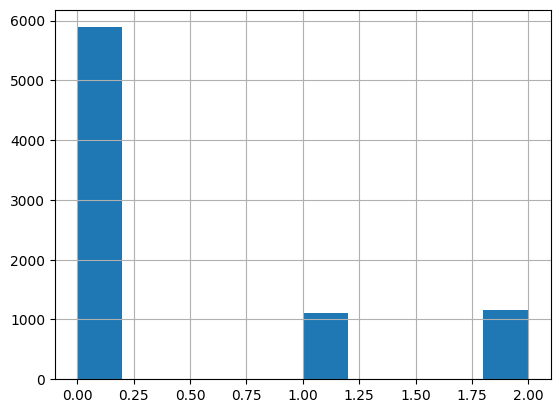

In [ ]:
#Target flexible way
pipdiff = 5 #for TP
SLTPRatio = 0.5 #pipdiff/Ratio gives SL
def mytarget(barsupfront, df1):
    length = len(df1)
    high = list(df1['High'])
    low = list(df1['Low'])
    close = list(df1['Close'])
    open = list(df1['Open'])
    trendcat = [None] * length
    for line in range (0,length-barsupfront-2):
        valueOpenLow = 0
        valueOpenHigh = 0
        for i in range(1,barsupfront+2):
            value1 = open[line+1]-low[line+i]
            value2 = open[line+1]-high[line+i]
            valueOpenLow = max(value1, valueOpenLow)
            valueOpenHigh = min(value2, valueOpenHigh)
            if ( (valueOpenLow >= pipdiff) and (-valueOpenHigh <= (pipdiff/SLTPRatio)) ):
                trendcat[line] = 2 #-1 downtrend
                break
            elif ( (valueOpenLow <= (pipdiff/SLTPRatio)) and (-valueOpenHigh >= pipdiff) ):
                trendcat[line] = 1 # uptrend
                break
            else:
                trendcat[line] = 0 # no clear trend

    return trendcat


#!!! pitfall one category high frequency
df['Target'] = mytarget(3, df)
#df.tail(20)
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(axis=0, inplace=True)

# Convert columns to integer type
df = df.astype(int)
#df['Target'] = df['Target'].astype(int)
df['Target'].hist()

count_of_twos_target = df['Target'].value_counts().get(2, 0)
count_of_zeros_target = df['Target'].value_counts().get(0, 0)
count_of_ones_target = df['Target'].value_counts().get(1, 0)
percent_of_zeros_over_ones_and_twos = (100 - (count_of_zeros_target/ (count_of_zeros_target + count_of_ones_target + count_of_twos_target))*100)
print(f' count_of_zeros = {count_of_zeros_target}\n count_of_twos_target = {count_of_twos_target}\n count_of_ones_target={count_of_ones_target}\n percent_of_zeros_over_ones_and_twos = {round(percent_of_zeros_over_ones_and_twos,2)}%')


# Check for NaN values:
has_nan = df['Target'].isnull().values.any()
print("NaN values present:", has_nan)

# Check for infinite values:
has_inf = df['Target'].isin([np.inf, -np.inf]).values.any()
print("Infinite values present:", has_inf)

# Count the number of NaN and infinite values:
nan_count = df['Target'].isnull().sum()
inf_count = (df['Target'] == np.inf).sum() + (df['Target'] == -np.inf).sum()
print("Number of NaN values:", nan_count)
print("Number of infinite values:", inf_count)

# Get the indices of NaN and infinite values:
nan_indices = df['Target'].index[df['Target'].isnull()]
inf_indices = df['Target'].index[df['Target'].isin([np.inf, -np.inf])]
print("Indices of NaN values:", nan_indices)
df['Target']

In [ ]:
def SIGNAL(df):
    return df['Target']

from backtesting import Strategy

class MyCandlesStrat(Strategy):
    def init(self):
        super().init()
        self.signal1 = self.I(SIGNAL, self.data)

    def next(self):
        super().next()
        if self.signal1 == 1:
            sl_pct = 0.02  # 2% stop-loss
            tp_pct = 0.05  # 5% take-profit
            sl_price = self.data.Close[-1] * (1 - sl_pct)
            tp_price = self.data.Close[-1] * (1 + tp_pct)
            self.buy(sl=sl_price, tp=tp_price)
        elif self.signal1 == 2:
            sl_pct = 0.02  # 2% stop-loss
            tp_pct = 0.05  # 5% take-profit
            sl_price = self.data.Close[-1] * (1 + sl_pct)
            tp_price = self.data.Close[-1] * (1 - tp_pct)
            self.sell(sl=sl_price, tp=tp_price)

bt = Backtest(df, MyCandlesStrat, cash=100000, commission=.001)
stat = bt.run()
stat

Backtest.run:   0%|          | 0/8149 [00:00<?, ?bar/s]

/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4978: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4984: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4992: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4993: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=4994: Broker canceled the relative-sized order due to insufficient margin.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/backtesting/backtesting.py:954: UserWarning: time=

,0
Start,2023-12-28 17:15:00
End,2024-12-27 20:30:00
Duration,365 days 03:15:00
Exposure Time [%],74.134969
Equity Final [$],125397.25753
Equity Peak [$],135356.63635
Commissions [$],2841.87347
Return [%],25.397258
Buy & Hold Return [%],25.927711
Return (Ann.) [%],67.827444


In [ ]:
attributes = ['trend', 'Target']
df_model= df[attributes].copy()

df_model['signal1'] = pd.Categorical(df_model['trend'])
dfDummies = pd.get_dummies(df_model['signal1'], prefix = 'signalcategory')
df_model= df_model.drop(['signal1'], axis=1)
df_model= df_model.drop(['trend'], axis=1)
df_model = pd.concat([df_model, dfDummies.astype(int)], axis=1)
df_model

,Target,signalcategory_0,signalcategory_1,signalcategory_2
Date,,,,
2023-12-28 17:15:00,0,1,0,0
2023-12-28 17:30:00,0,1,0,0
2023-12-28 17:45:00,0,1,0,0
2023-12-28 18:00:00,0,1,0,0
2023-12-28 18:15:00,2,1,0,0
...,...,...,...,...
2024-12-27 19:30:00,2,1,0,0
2024-12-27 19:45:00,2,1,0,0
2024-12-27 20:00:00,0,1,0,0


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [21:23:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "scale_pos_weight" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in l

****Train Results****
Accuracy: 78.0018%
****Test Results****
Accuracy: 58.7730%
[[4450    0    0]
 [ 621    0    0]
 [ 634    0    0]]
[[1437    0    0]
 [ 484    0    0]
 [ 524    0    0]]
              precision    recall  f1-score   support

           0       0.78      1.00      0.88      4450
           1       0.00      0.00      0.00       621
           2       0.00      0.00      0.00       634

    accuracy                           0.78      5705
   macro avg       0.26      0.33      0.29      5705
weighted avg       0.61      0.78      0.68      5705

              precision    recall  f1-score   support

           0       0.59      1.00      0.74      1437
           1       0.00      0.00      0.00       484
           2       0.00      0.00      0.00       524

    accuracy                           0.59      2445
   macro avg       0.20      0.33      0.25      2445
weighted avg       0.35      0.59      0.44      2445

['signalcategory_0', 'signalcategory_1', 'signa

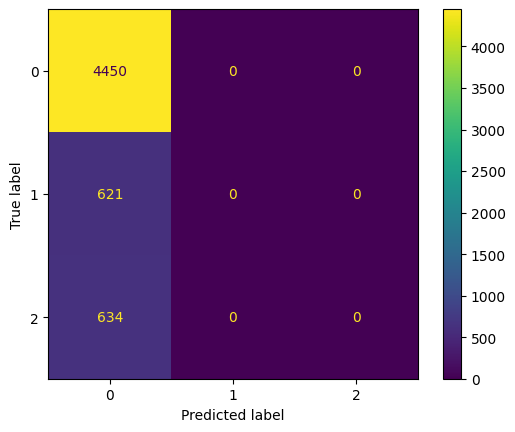

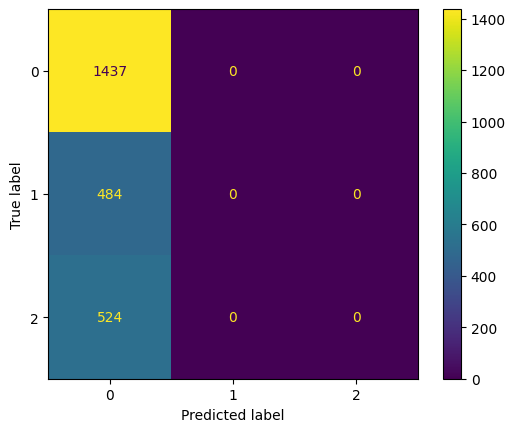

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

attributes = ['signalcategory_0', 'signalcategory_1', 'signalcategory_2']
X = df_model[attributes]
y = df_model['Target']

train_pct_index = int(0.7 * len(X))
X_train, X_test = X[:train_pct_index], X[train_pct_index:]
y_train, y_test = y[:train_pct_index], y[train_pct_index:]

# Calculate class weights
class_labels = np.unique(y_train)
class_weight = compute_class_weight('balanced', classes=class_labels, y=y_train)
class_weight_dict = dict(zip(class_labels, class_weight))
combined_weight = sum(class_weight[1:]) / sum(class_weight)  # Combine weights for classes 1 and 2

# Adjust class weights manually to give more weight to classes 1 and 2
class_weight_dict[0] = 1.0  # weight for class 0
class_weight_dict[1] = 5.0  # weight for class 1
class_weight_dict[2] = 5.0  # weight for class 2

model = XGBClassifier(objective="multi:softmax", eval_metric="merror", scale_pos_weight=class_weight_dict, n_estimators=400, max_depth=3, early_stopping_rounds=10, gamma=0.2, reg_alpha=0.5, reg_lambda=1.0)
model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=False)
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)

acc_train = accuracy_score(y_train, pred_train)
acc_test = accuracy_score(y_test, pred_test)
print('****Train Results****')
print("Accuracy: {:.4%}".format(acc_train))
print('****Test Results****')
print("Accuracy: {:.4%}".format(acc_test))

# Predict probabilities
y_prob = model.predict_proba(X_test)

# Adjust the threshold
threshold = 0.3  # Adjust this threshold as needed
y_pred = (y_prob[:,1] > threshold).astype(int)

matrix_train = confusion_matrix(y_train, pred_train)
matrix_test = confusion_matrix(y_test, pred_test)

print(matrix_train)
print(matrix_test)

report_train = classification_report(y_train, pred_train)
report_test = classification_report(y_test, pred_test)

print(report_train)
print(report_test)
print(model.get_booster().feature_names)

# Training Confusion Matrix
cm_train = confusion_matrix(y_train, pred_train)
ConfusionMatrixDisplay(cm_train).plot()

# Test Confusion Matrix
cm_test = confusion_matrix(y_test, pred_test)
ConfusionMatrixDisplay(cm_test).plot()

Classification Report (Entire Dataset):
              precision    recall  f1-score   support

           0       0.72      1.00      0.84      5887
           1       0.00      0.00      0.00      1105
           2       0.00      0.00      0.00      1158

    accuracy                           0.72      8150
   macro avg       0.24      0.33      0.28      8150
weighted avg       0.52      0.72      0.61      8150

Confusion Matrix (Entire Dataset):
[[5887    0    0]
 [1105    0    0]
 [1158    0    0]]
Confusion Matrix - Entire Dataset:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


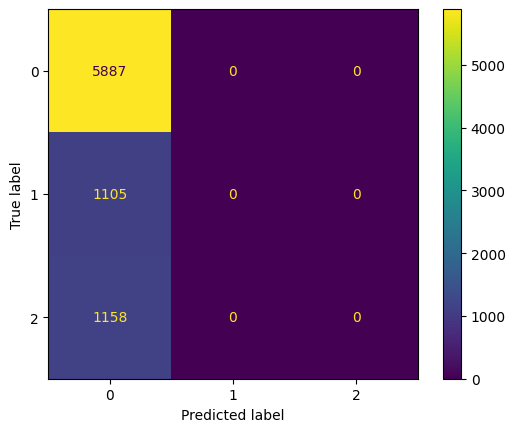

In [ ]:
y_pred_entire_dataset = model.predict(X)

# Evaluate the loaded model
print("Classification Report (Entire Dataset):")
print(classification_report(y, y_pred_entire_dataset))
print("Confusion Matrix (Entire Dataset):")
print(confusion_matrix(y, y_pred_entire_dataset))
cm_entire_dataset = confusion_matrix(y, y_pred_entire_dataset)
print("Confusion Matrix - Entire Dataset:")
ConfusionMatrixDisplay(cm_entire_dataset).plot()

In [ ]:
!pip install numpy==1.23.5



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 24.4 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
blosc2 3.5.1 requires numpy>=1.26, but you have numpy 1.23.5 which is incompatible.
db-dtypes 1.4.3 requires numpy>=1.24.0, but you have numpy 1.23.5 which is incompatible.
scikit-image 0.25.2 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.23.5 which is incompatible.
treescope 0.1.9 requires numpy>=1.25.2, but you have numpy 1.23.5 which is incompatible.
bigframes 2.8.0 requires numpy>=1.24.0, but you have numpy 1.23.5 which is incompatible.
xarray-einstats 0.9.

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [21:23:14] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "scale_pos_weight" } are not used.

  warnings.warn(smsg, UserWarning)


****Train Results****
Accuracy: 34.7191%
****Test Results****
Accuracy: 25.4397%
[[ 413    0 4037]
 [ 377    0 4073]
 [ 228    0 4222]]
[[ 141    0 1296]
 [  42    0  442]
 [  43    0  481]]
              precision    recall  f1-score   support

           0       0.41      0.09      0.15      4450
           1       0.00      0.00      0.00      4450
           2       0.34      0.95      0.50      4450

    accuracy                           0.35     13350
   macro avg       0.25      0.35      0.22     13350
weighted avg       0.25      0.35      0.22     13350

              precision    recall  f1-score   support

           0       0.62      0.10      0.17      1437
           1       0.00      0.00      0.00       484
           2       0.22      0.92      0.35       524

    accuracy                           0.25      2445
   macro avg       0.28      0.34      0.17      2445
weighted avg       0.41      0.25      0.17      2445

['signalcategory_0', 'signalcategory_1', 'signa

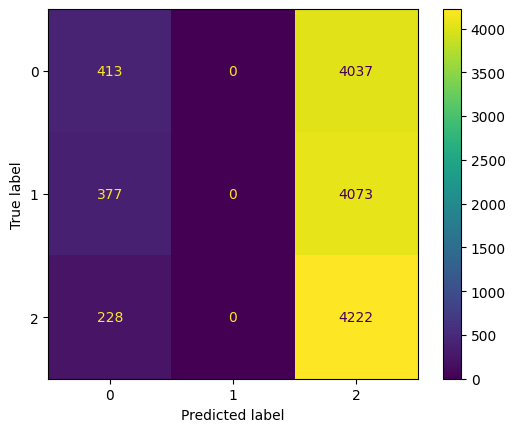

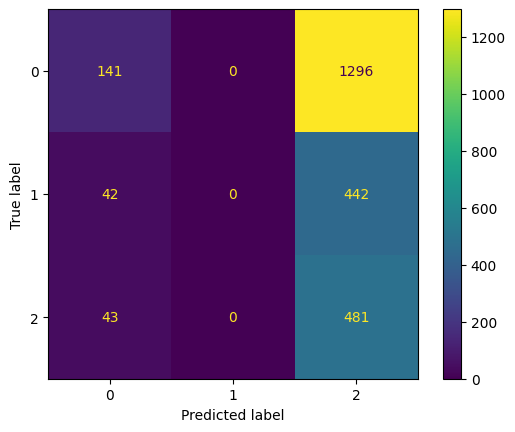

In [ ]:
from imblearn.over_sampling import RandomOverSampler

# Oversample minority classes
ros = RandomOverSampler(sampling_strategy='not majority')
X_train_resampled, y_train_resampled = ros.fit_resample(X_train, y_train)

# Train the model on the resampled data
model.fit(X_train_resampled, y_train_resampled, eval_set=[(X_test, y_test)], verbose=False)


pred_train = model.predict(X_train_resampled)
pred_test = model.predict(X_test)

acc_train = accuracy_score(y_train_resampled, pred_train)
acc_test = accuracy_score(y_test, pred_test)
print('****Train Results****')
print("Accuracy: {:.4%}".format(acc_train))
print('****Test Results****')
print("Accuracy: {:.4%}".format(acc_test))

# Predict probabilities
y_prob = model.predict_proba(X_test)

# Adjust the threshold
threshold = 0.3  # Adjust this threshold as needed
y_pred = (y_prob[:,1] > threshold).astype(int)

matrix_train = confusion_matrix(y_train_resampled, pred_train)
matrix_test = confusion_matrix(y_test, pred_test)

print(matrix_train)
print(matrix_test)

report_train = classification_report(y_train_resampled, pred_train)
report_test = classification_report(y_test, pred_test)

print(report_train)
print(report_test)
print(model.get_booster().feature_names)


# Training Confusion Matrix
cm_train = confusion_matrix(y_train_resampled, pred_train)
ConfusionMatrixDisplay(cm_train).plot()

# Test Confusion Matrix
cm_test = confusion_matrix(y_test, pred_test)
ConfusionMatrixDisplay(cm_test).plot()